In [12]:
import pandas as pd
import plotly.express as px

In [140]:
caracteristiques = pd.read_csv("carcteristiques-2022.csv", sep=';')
caracteristiques.drop('adr', axis=1,inplace = True)
caracteristiques

,Accident_Id,jour,mois,an,hrmn,lum,dep,com,agg,int,atm,col,lat,long
0,202200000001,19,10,2022,16:15,1,26,26198,2,3,1,3,"44,5594200000","4,7257200000"
1,202200000002,20,10,2022,08:34,1,25,25204,2,3,1,3,"46,9258100000","6,3462000000"
2,202200000003,20,10,2022,17:15,1,22,22360,2,6,1,2,"48,4931620000","-2,7604390000"
3,202200000004,20,10,2022,18:00,1,16,16102,2,3,8,6,"45,6926520000","-0,3262900000"
4,202200000005,19,10,2022,11:45,1,13,13103,1,1,1,2,"43,6755790366","5,0927031775"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55297,202200055298,1,1,2022,03:50,3,2B,2B293,1,1,1,6,"42,3101650000","9,4785830000"
55298,202200055299,1,1,2022,07:20,3,84,84074,1,1,1,6,"43,7531640000","5,2244760000"
55299,202200055300,1,1,2022,04:27,3,74,74001,1,1,9,6,"46,2825320000","6,7328060000"
55300,202200055301,1,1,2022,08:40,1,81,81099,1,3,1,3,"43,9272650000","1,9156370000"


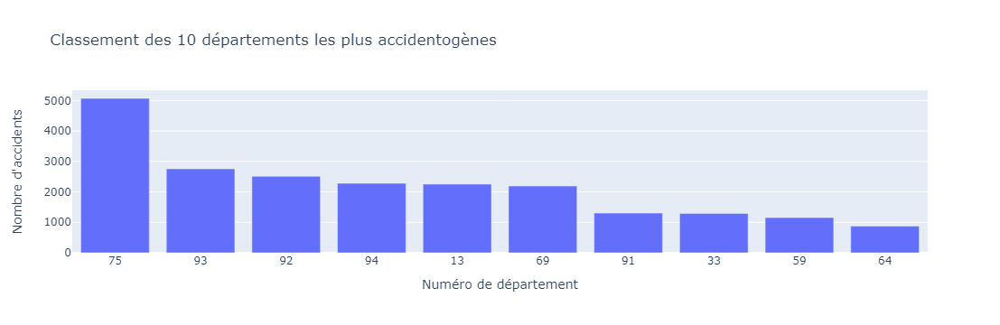

In [46]:
classement_departements_accidentogenes = caracteristiques.groupby('dep')['dep'].count().sort_values(ascending=False).head(10)
x = classement_departements_accidentogenes.index
y = classement_departements_accidentogenes.values
px.bar(x=classement_departements_accidentogenes.index,y=classement_departements_accidentogenes.values, labels={"x":"Numéro de département","y":"Nombre d'accidents"}, title="Classement des 10 départements les plus accidentogènes")

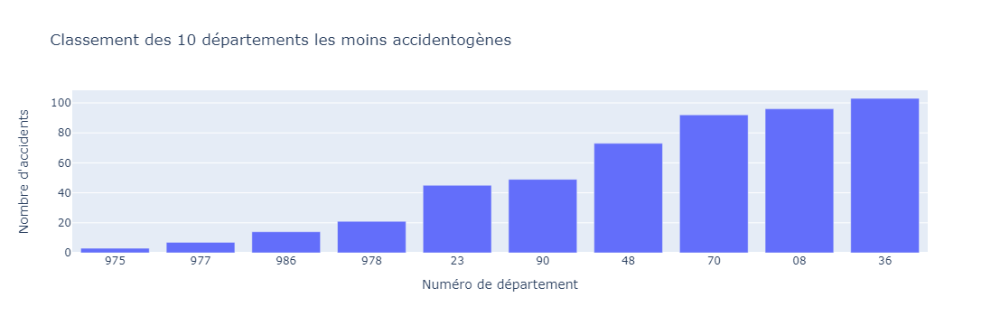

In [43]:
classement_departements_accidentogenes = caracteristiques.groupby('dep')['dep'].count().sort_values().head(10)
x = classement_departements_accidentogenes.index
y = classement_departements_accidentogenes.values
px.bar(x=classement_departements_accidentogenes.index,y=classement_departements_accidentogenes.values, title="Classement des 10 départements les moins accidentogènes", labels={"x":"Numéro de département","y":"Nombre d'accidents"})

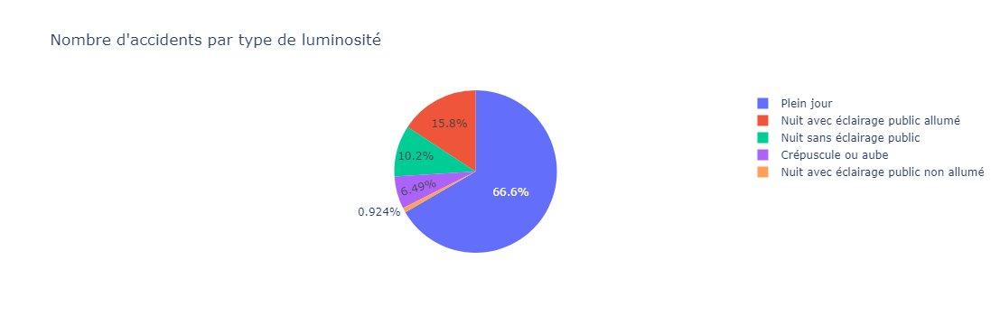

In [5]:
lumiere = {1:"Plein jour",2:"Crépuscule ou aube",3:"Nuit sans éclairage public",4:"Nuit avec éclairage public non allumé",
           5:"Nuit avec éclairage public allumé"}
caracteristiques['luminosite']=caracteristiques['lum'].map(lumiere)
accident_par_luminosite = caracteristiques.groupby('luminosite')['Accident_Id'].count()
x=accident_par_luminosite.index
y=accident_par_luminosite.values
px.pie(accident_par_luminosite, names=x, values=y, title="Nombre d'accidents par type de luminosité")

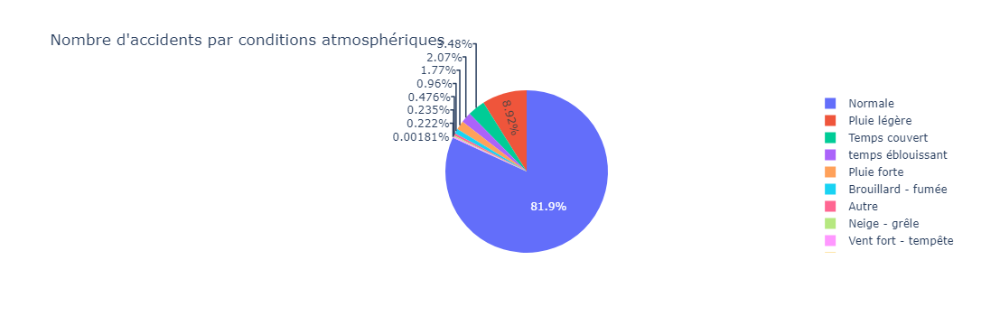

In [6]:
conditions_atm = {-1:"Non renseigné",1:"Normale",2:"Pluie légère",3:"Pluie forte",4:"Neige - grêle",
                  5:"Brouillard - fumée",6:"Vent fort - tempête",7:"temps éblouissant",8:"Temps couvert",
                  9:"Autre"}
caracteristiques['atm_libelle'] = caracteristiques['atm'].map(conditions_atm) 
accident_par_conditions_atm = caracteristiques.groupby('atm_libelle')['Accident_Id'].count()
x=accident_par_conditions_atm.index
y=accident_par_conditions_atm.values
px.pie(accident_par_luminosite, names=x, values=y, title="Nombre d'accidents par conditions atmosphériques")

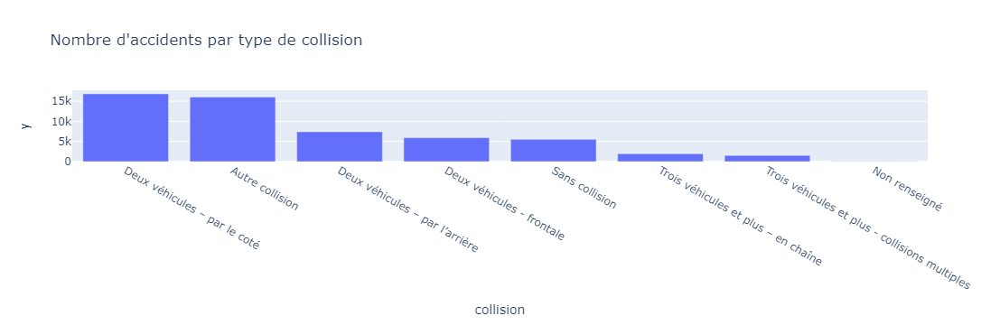

In [7]:
type_collision = {-1:"Non renseigné",1:"Deux véhicules - frontale",2:"Deux véhicules – par l’arrière",
                 3:"Deux véhicules – par le coté",4:"Trois véhicules et plus – en chaîne",5:"Trois véhicules et plus - collisions multiples",
                 6:"Autre collision",7:"Sans collision"}
caracteristiques['collision'] = caracteristiques['col'].map(type_collision)
accident_par_type_de_collision = caracteristiques.groupby('collision')['Accident_Id'].count().sort_values(ascending=False)
x = accident_par_type_de_collision.index
y=accident_par_type_de_collision.values
px.bar(accident_par_type_de_collision,x,y, title="Nombre d'accidents par type de collision")


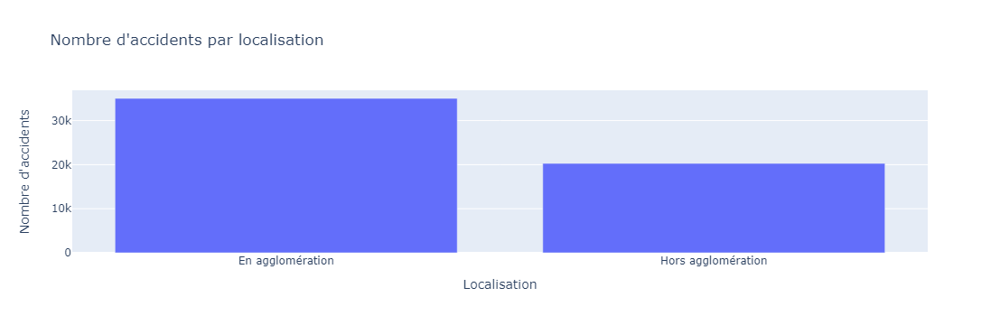

In [8]:
localisation = {1:"Hors agglomération",2:"En agglomération"}
caracteristiques['localisation']=caracteristiques['agg'].map(localisation)
accident_par_localisation = caracteristiques.groupby('localisation')['Accident_Id'].count()
x=accident_par_localisation.index
y=accident_par_localisation.values
px.bar(x=x, y=y, title="Nombre d'accidents par localisation", labels={'x':'Localisation', 'y':"Nombre d'accidents"})

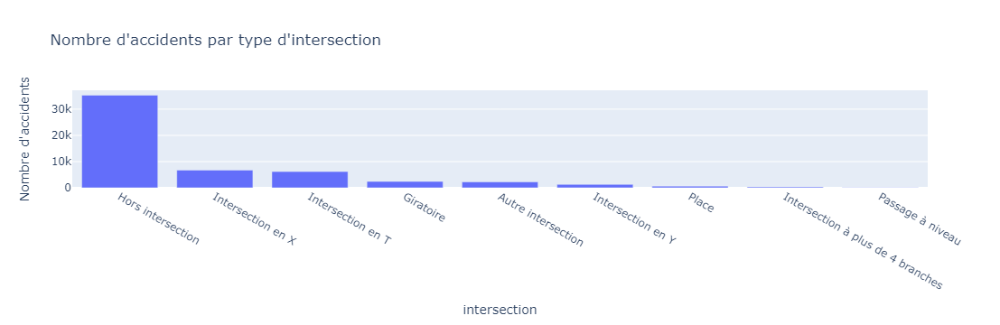

In [9]:
intersection ={1:"Hors intersection",2:"Intersection en X",3:"Intersection en T",4:"Intersection en Y",
               5:"Intersection à plus de 4 branches",6:"Giratoire",7:"Place",8:"Passage à niveau",9:"Autre intersection"}
caracteristiques['intersection']=caracteristiques['int'].map(intersection)
accident_par_intersection = caracteristiques.groupby('intersection')['Accident_Id'].count().sort_values(ascending=False)
x=accident_par_intersection.index
y=accident_par_intersection.values
px.bar(accident_par_intersection,x,y,title="Nombre d'accidents par type d'intersection", labels={'y' : "Nombre d'accidents"})

In [22]:
caracteristiques['lat'] = caracteristiques['lat'].str.replace(',', '.')
caracteristiques['long'] = caracteristiques['long'].str.replace(',', '.')
caracteristiques['lat'] = pd.to_numeric(caracteristiques['lat'], errors='coerce')
caracteristiques['long'] = pd.to_numeric(caracteristiques['long'], errors='coerce')

choisissez un département 45


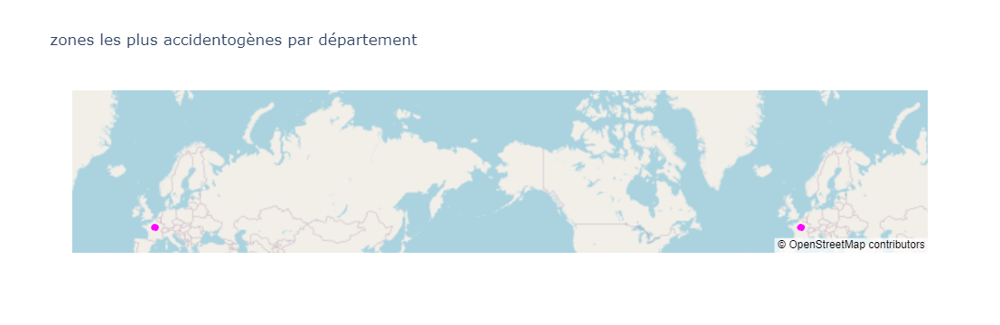

In [26]:
departement = input("choisissez un département")
departement = caracteristiques[caracteristiques['dep'] == departement]
                    
                    
px.scatter_mapbox(departement, lat="lat", lon="long", hover_name="dep",
                        hover_data=['Accident_Id'], color_discrete_sequence=["fuchsia"],
                        zoom=5, height=300, mapbox_style="open-street-map", title="zones les plus accidentogènes par département")

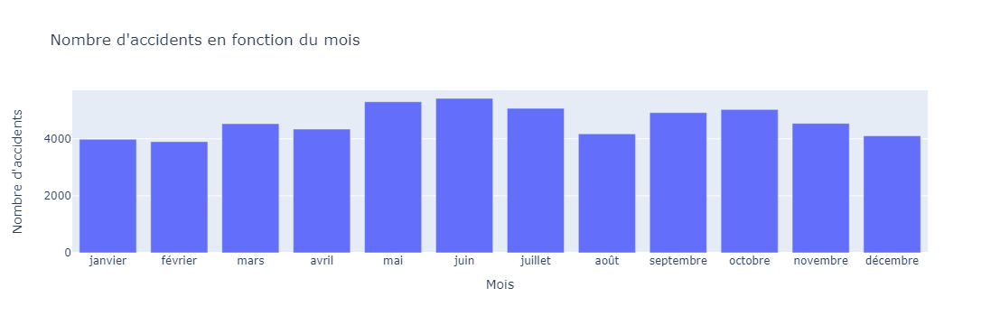

In [40]:
libellé_mois = {1:"janvier",2:"février",3:"mars",4:"avril",5:"mai",6:"juin",7:"juillet",8:"août",9:"septembre",10:"octobre",11:"novembre",12:"décembre"}
caracteristiques['libellé_mois']=caracteristiques['mois'].map(libellé_mois)
accidents_par_mois = caracteristiques.groupby('libellé_mois')['Accident_Id'].count()
ordre_mois = ["janvier", "février", "mars", "avril", "mai", "juin", "juillet", "août", "septembre", "octobre", "novembre", "décembre"]
accidents_par_mois = accidents_par_mois.reindex(ordre_mois)
px.bar(x=accidents_par_mois.index, y=accidents_par_mois.values, labels={'x':'Mois', 'y':"Nombre d'accidents"}, title="Nombre d'accidents en fonction du mois")

In [142]:
caracteristiques['heure'] = pd.to_datetime(caracteristiques['hrmn'], format='%H:%M')

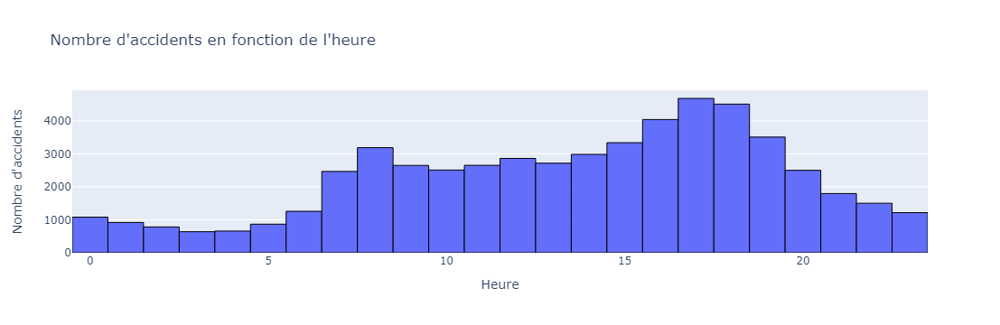

In [143]:
caracteristiques['heure'] = caracteristiques['heure'].dt.hour
fig = px.histogram(x=caracteristiques['heure'], labels={'x':'Heure', 'y':"Nombre d'accidents"},
                   nbins=24, title="Nombre d'accidents en fonction de l'heure")
fig.update_yaxes(title_text="Nombre d'accidents")
fig.update_traces(marker_line_color='black', marker_line_width=1)

### Num_Acc
Numéro d'identifiant de l’accident.
### jour mois
Jour de l'accident.
Mois de l'accident.
### an
Année de l'accident.
### hrmn
Heure et minutes de l'accident.
### lum
Lumière : conditions d’éclairage dans lesquelles l'accident s'est produit :

1 – Plein jour

2 – Crépuscule ou aube

3 – Nuit sans éclairage public

4 – Nuit avec éclairage public non allumé

5 – Nuit avec éclairage public allumé

### dep
Département : Code INSEE (Institut National de la Statistique et des Etudes Economiques) du département (2A Corse-du-Sud – 2B Haute-Corse).
### com
Commune : Le numéro de commune est un code donné par l‘INSEE. Le code est composé du code INSEE du département suivi par 3 chiffres.
### agg
Localisation :

1 – Hors agglomération 
2 – En agglomération
### int
Intersection :

1 – Hors intersection

2 – Intersection en X

3 – Intersection en T

4 – Intersection en Y

5 – Intersection à plus de 4 branches

6 – Giratoire

7 – Place

8 – Passage à niveau

9 – Autre intersection

### atm
Conditions atmosphériques :

-1 – Non renseigné

1 – Normale

2 – Pluie légère

3 – Pluie forte

4 – Neige - grêle

5 – Brouillard - fumée

6 – Vent fort - tempête

7 – Temps éblouissant

8 – Temps couvert

9 – Autre

### col
Type de collision :

-1 – Non renseigné

1 – Deux véhicules - frontale

2 – Deux véhicules – par l’arrière

3 – Deux véhicules – par le coté

4 – Trois véhicules et plus – en chaîne

5 – Trois véhicules et plus - collisions multiples

6 – Autre collision

7 – Sans collision
### lat
Latitude
### Long
Longitude

In [65]:
lieux = pd.read_csv("lieux-2022.csv", sep=';',low_memory=False)
lieux.head()

,Num_Acc,catr,voie,v1,v2,circ,nbv,vosp,prof,pr,pr1,plan,lartpc,larrout,surf,infra,situ,vma
0,202200000001,4,TEIL(vieille route du),0,NaN,2,2,0,1,(1),(1),1,NaN,-1,1,0,1,50
1,202200000002,4,NaN,0,NaN,2,2,0,1,(1),(1),1,NaN,-1,1,0,1,50
2,202200000003,3,ROND POINT DE BREZILLET,0,NaN,-1,2,0,1,0,0,1,NaN,-1,1,5,1,50
3,202200000004,4,QUATORZE JUILLET (RUE DU),0,NaN,1,1,0,2,(1),(1),1,NaN,4,1,0,1,30
4,202200000005,3,ROUTE DE JEAN MOULIN-RN 538,0,NaN,2,2,0,1,8,0,1,NaN,-1,1,0,1,80


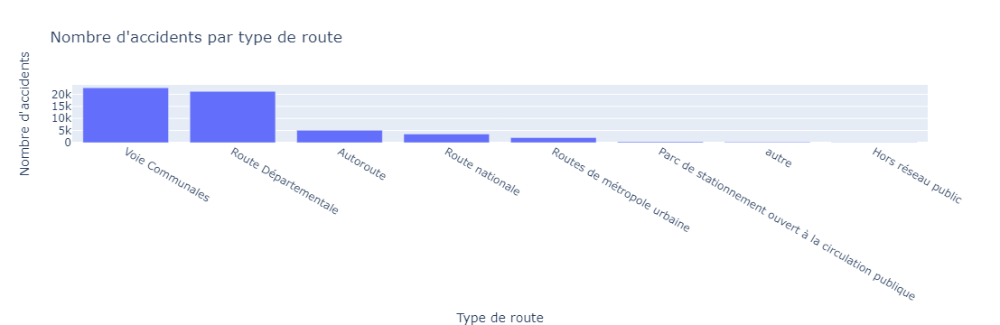

In [73]:
route = {1:"Autoroute",2:"Route nationale",3:"Route Départementale",4:"Voie Communales",5:"Hors réseau public",
         6:"Parc de stationnement ouvert à la circulation publique",7:"Routes de métropole urbaine",9:"autre"}
lieux['type_route'] = lieux['catr'].map(route)
accidents_par_type_route = lieux.groupby('type_route')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_type_route.index, y=accidents_par_type_route.values, labels={'x' : 'Type de route', 'y':"Nombre d'accidents"}, title="Nombre d'accidents par type de route")

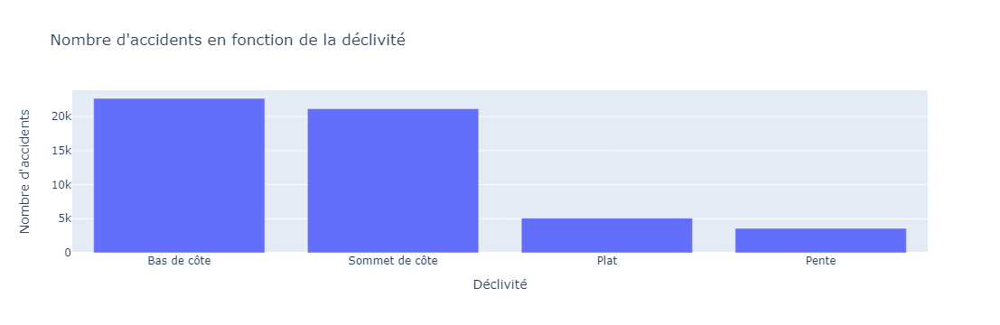

In [77]:
declivite = {-1:"Non renseigné",1:"Plat",2:"Pente",3:"Sommet de côte",4:"Bas de côte"}
lieux['declivite']=lieux['catr'].map(declivite)
accidents_par_declivite = lieux.groupby('declivite')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_declivite.index,y=accidents_par_declivite.values, title="Nombre d'accidents en fonction de la déclivité", labels={'x':'Déclivité','y':"Nombre d'accidents"})             

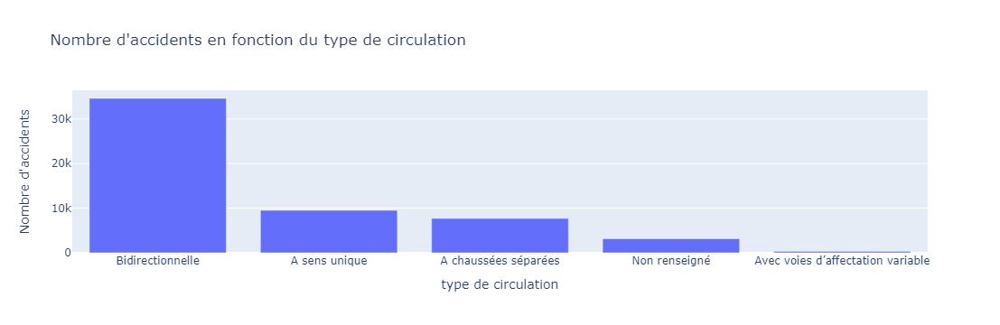

In [79]:
circulation = {-1:'Non renseigné',1:'A sens unique',2:'Bidirectionnelle',3:'A chaussées séparées',4:'Avec voies d’affectation variable'}
lieux['circulation']=lieux['circ'].map(circulation)
accidents_par_circulation = lieux.groupby('circulation')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_circulation.index,y=accidents_par_circulation.values,title="Nombre d'accidents en fonction du type de circulation",labels={'x':'type de circulation','y':"Nombre d'accidents"})

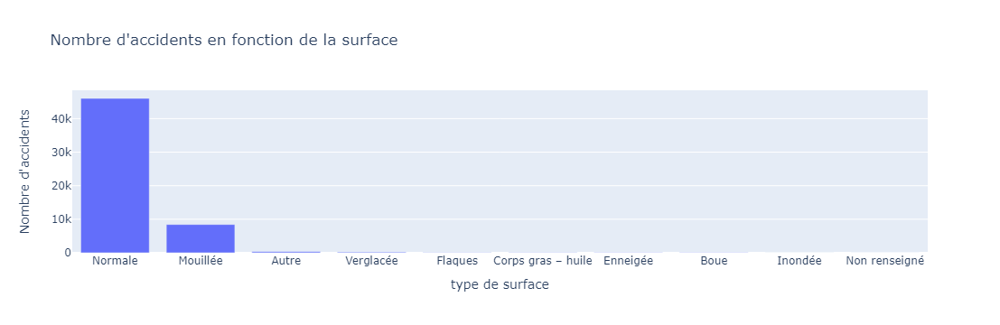

In [81]:
surface = {-1:'Non renseigné',1:'Normale',2:'Mouillée',3:'Flaques',4:'Inondée',5:'Enneigée',6:'Boue',7:'Verglacée',8:'Corps gras – huile',9:'Autre'}
lieux['surface']=lieux['surf'].map(surface)
accidents_par_surface=lieux.groupby('surface')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_surface.index,y=accidents_par_surface.values,title="Nombre d'accidents en fonction de la surface",
       labels={'x':'type de surface','y':"Nombre d'accidents"})

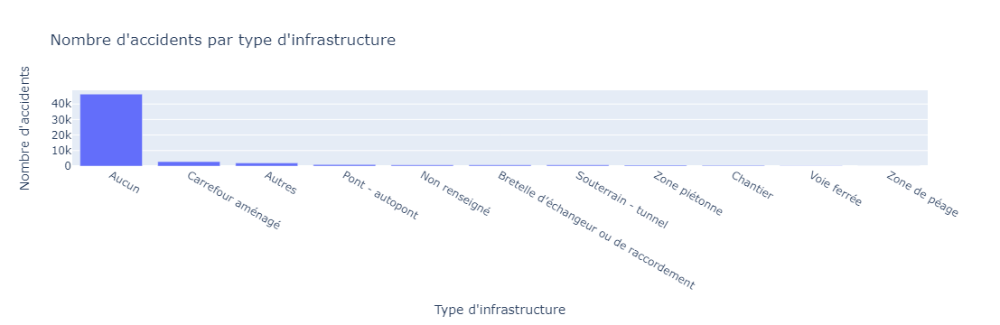

In [82]:
infrastructure = {-1:'Non renseigné',0:'Aucun',1:'Souterrain - tunnel',2:'Pont - autopont',3:'Bretelle d’échangeur ou de raccordement',
                  4:'Voie ferrée',5:'Carrefour aménagé',6:'Zone piétonne',7:'Zone de péage',8:'Chantier',9:'Autres'}
lieux['infrastructure']=lieux['infra'].map(infrastructure)
accidents_par_infrastructure=lieux.groupby('infrastructure')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_infrastructure.index,y=accidents_par_infrastructure.values,title="Nombre d'accidents par type d'infrastructure",
       labels={'x':"Type d'infrastructure","y":"Nombre d'accidents"})

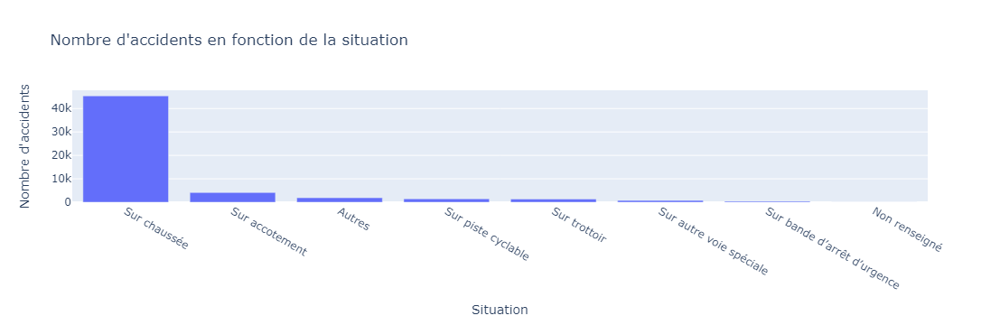

In [84]:
situation = {-1:'Non renseigné',0:'Aucun',1:'Sur chaussée',2:'Sur bande d’arrêt d’urgence',3:'Sur accotement',
             4:'Sur trottoir',5:'Sur piste cyclable',6:'Sur autre voie spéciale',8:'Autres'}
lieux['situation']=lieux['situ'].map(situation)
accidents_par_situation = lieux.groupby('situation')['Num_Acc'].count().sort_values(ascending=False)
px.bar(x=accidents_par_situation.index,y=accidents_par_situation.values, title="Nombre d'accidents en fonction de la situation",
       labels={'x':'Situation','y':"Nombre d'accidents"})

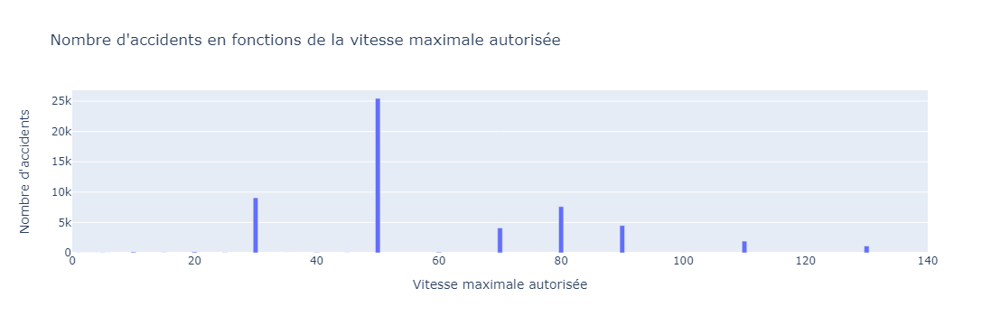

In [93]:
accidents_va = lieux.groupby('vma')['Num_Acc'].count().sort_values(ascending=False)
fig = px.bar(x=accidents_va.index,y=accidents_va.values,title="Nombre d'accidents en fonctions de la vitesse maximale autorisée",
       labels={'x':"Vitesse maximale autorisée",'y':"Nombre d'accidents"})
fig.update_xaxes(range=[0, 140])

### Num_Acc
Identifiant de l’accident identique à celui du fichier "rubrique CARACTERISTIQUES" repris dans l’accident.
### catr
Catégorie de route :
    
1 – Autoroute
    
2 – Route nationale
    
3 – Route Départementale
    
4 – Voie Communales
    
5 – Hors réseau public
    
6 – Parc de stationnement ouvert à la circulation publique
    
7 – Routes de métropole urbaine
    
9 – autre
    
### voie
Numéro de la route.
### V1
Indice numérique du numéro de route (exemple : 2 bis, 3 ter etc.).
### V2
Lettre indice alphanumérique de la route.
### circ
Régime de circulation :
    
-1 – Non renseigné
    
1 – A sens unique
    
2 – Bidirectionnelle
    
3 – A chaussées séparées
    
4 – Avec voies d’affectation variable
    
### nbv
Nombre total de voies de circulation.
###vosp
Signale l’existence d’une voie réservée, indépendamment du fait que l’accident ait lieu ou non sur cette voie.
    
-1 – Non renseigné
    
0 – Sans objet
    
1 – Piste cyclable
    
2 – Bande cyclable
    
3 – Voie réservée
    
### prof
Profil en long décrit la déclivité de la route à l'endroit de l'accident :
    
-1 – Non renseigné
    
1 – Plat
    
2 – Pente
    
3 – Sommet de côte
    
4 – Bas de côte
    
### pr
Numéro du PR de rattachement (numéro de la borne amont). La valeur -1 signifie que le PR n’est pas renseigné.
    
### pr1
Distance en mètres au PR (par rapport à la borne amont). La valeur -1 signifie que le PR n’est pas renseigné.
### plan
Tracé en plan :
    
-1 – Non renseigné
    
1 – Partie rectiligne
    
2 – En courbe à gauche
    
3 – En courbe à droite
    
4 – En « S »
    
### lartpc
Largeur du terre-plein central (TPC) s'il existe (en m).
    
### larrout
Largeur de la chaussée affectée à la circulation des véhicules ne sont pas compris les bandes d'arrêt d'urgence, les TPC et les places de stationnement (en m).
### surf
Etat de la surface :

-1 – Non renseigné

1 – Normale

2 – Mouillée

3 – Flaques

4 – Inondée

5 – Enneigée

6 – Boue

7 – Verglacée

8 – Corps gras – huile

9 – Autre

### infra
Aménagement - Infrastructure :

-1 – Non renseigné

0 – Aucun

1 – Souterrain - tunnel

2 – Pont - autopont

3 – Bretelle d’échangeur ou de raccordement

4 – Voie ferrée

5 – Carrefour aménagé

6 – Zone piétonne

7 – Zone de péage

8 – Chantier

9 – Autres

### situ
Situation de l’accident :

-1 – Non renseigné

0 – Aucun

1 – Sur chaussée

2 – Sur bande d’arrêt d’urgence

3 – Sur accotement

4 – Sur trottoir

5 – Sur piste cyclable

6 – Sur autre voie spéciale

8 – Autres

### vma
Vitesse maximale autorisée sur le lieu et au moment de l’accident.

In [103]:
usagers = pd.read_csv("usagers-2022.csv", sep=';')
usagers.head()

,Num_Acc,id_usager,id_vehicule,num_veh,place,catu,grav,sexe,an_nais,trajet,secu1,secu2,secu3,locp,actp,etatp
0,202200000001,1 099 700,813 952,A01,1,1,3,1,2008.0,5,2,8,-1,-1,-1,-1
1,202200000001,1 099 701,813 953,B01,1,1,1,1,1948.0,5,1,8,-1,-1,-1,-1
2,202200000002,1 099 698,813 950,B01,1,1,4,1,1988.0,9,1,0,-1,0,0,-1
3,202200000002,1 099 699,813 951,A01,1,1,1,1,1970.0,4,1,0,-1,0,0,-1
4,202200000003,1 099 696,813 948,A01,1,1,1,1,2002.0,0,1,0,-1,-1,-1,-1


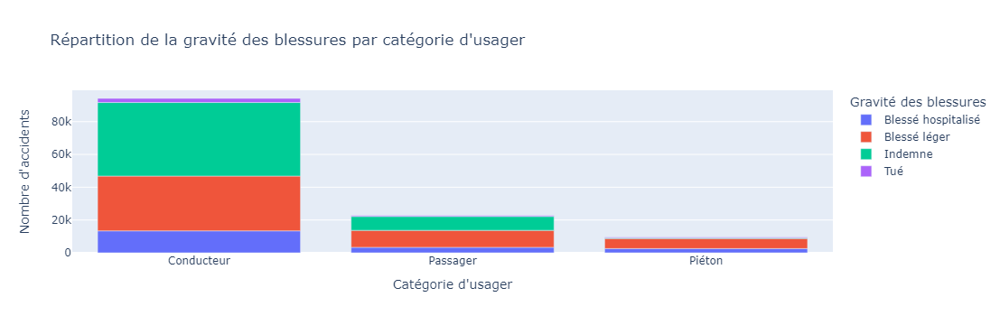

In [104]:
categorie_usager = {1:'Conducteur',2:'Passager',3:'Piéton'}
usagers['categorie_usager']=usagers['catu'].map(categorie_usager)
gravité = {1:'Indemne',2:'Tué',3:'Blessé hospitalisé',4:'Blessé léger'}
usagers['gravité']=usagers['grav'].map(gravité)
gravité_par_type_usager = usagers.groupby(['categorie_usager', 'gravité']).size().reset_index(name='count')
px.bar(gravité_par_type_usager, x='categorie_usager', y='count', color='gravité',
             labels={'categorie_usager': "Catégorie d'usager", 'count': "Nombre d'accidents", 'gravité': 'Gravité des blessures'},
             title="Répartition de la gravité des blessures par catégorie d'usager")

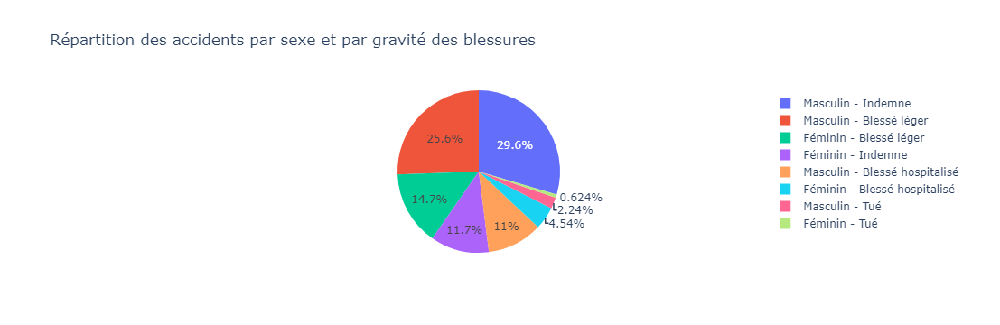

In [107]:
sexe = {1:'Masculin',2:'Féminin'}
usagers['sex']=usagers['sexe'].map(sexe)
data = usagers.groupby(['sex', 'gravité']).size().reset_index(name='count')
data['sex_gravité'] = data['sex'] + ' - ' + data['gravité']
px.pie(data, names='sex_gravité', values='count', 
             labels={'sex_gravité': 'Sexe et Gravité', 'count': 'Nombre d\'accidents'},
             title='Répartition des accidents par sexe et par gravité des blessures')

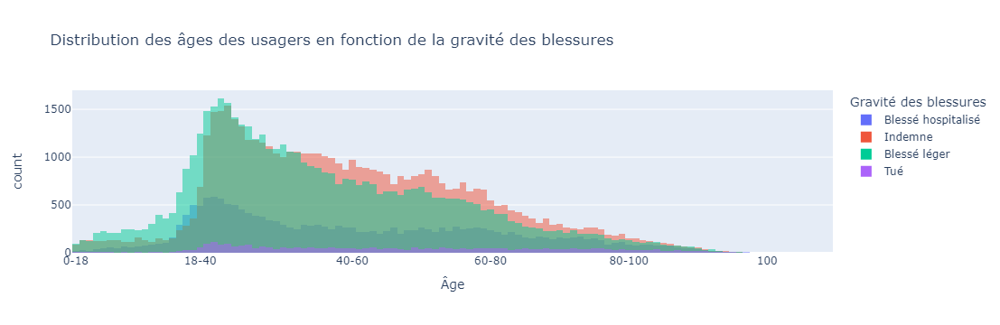

In [117]:
usagers['age']=2022-usagers['an_nais']
fig = px.histogram(usagers, x='age', color='gravité', 
                   labels={'age': 'Âge', 'gravité': 'Gravité des blessures'},
                   title='Distribution des âges des usagers en fonction de la gravité des blessures',
                   barmode='overlay')
fig.update_layout(
    xaxis=dict(
        tickmode='array',
        tickvals=[0, 18, 40, 60, 80, 100],
        ticktext=['0-18', '18-40', '40-60', '60-80', '80-100']))

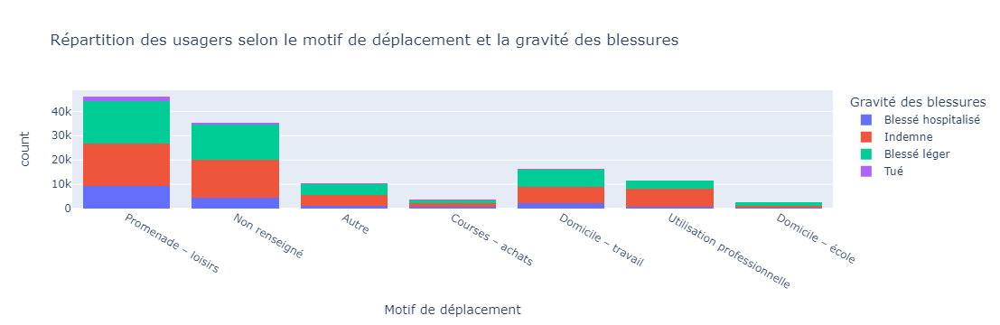

In [119]:
motif_deplacement = {-1:'Non renseigné',0:'Non renseigné',1:'Domicile – travail',2:'Domicile – école',
                     3:'Courses – achats',4:'Utilisation professionnelle',5:'Promenade – loisirs',9:'Autre'}
usagers['motif_déplacement']=usagers['trajet'].map(motif_deplacement)
px.histogram(usagers, x='motif_déplacement', color='gravité', 
                   labels={'motif_déplacement': 'Motif de déplacement', 'gravité': 'Gravité des blessures'},
                   title='Répartition des usagers selon le motif de déplacement et la gravité des blessures',
                   barmode='stack')

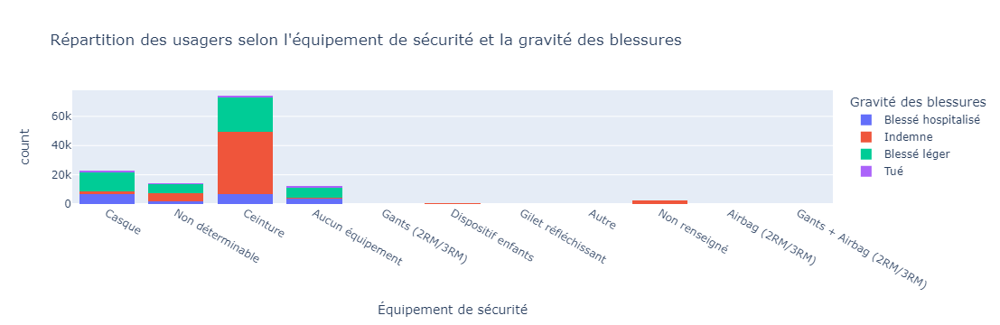

In [120]:
sécurité = {-1:'Non renseigné',0:'Aucun équipement',1:'Ceinture',2:'Casque',3:'Dispositif enfants',4:'Gilet réfléchissant',
            5:'Airbag (2RM/3RM)',6:'Gants (2RM/3RM)',7:'Gants + Airbag (2RM/3RM)',8:'Non déterminable',9:'Autre'}
usagers['équipement_sécurité'] = usagers['secu1'].map(sécurité)
px.histogram(usagers, x='équipement_sécurité', color='gravité', 
                   labels={'équipement_sécurité': 'Équipement de sécurité', 'gravité': 'Gravité des blessures'},
                   title='Répartition des usagers selon l\'équipement de sécurité et la gravité des blessures',
                   barmode='stack')

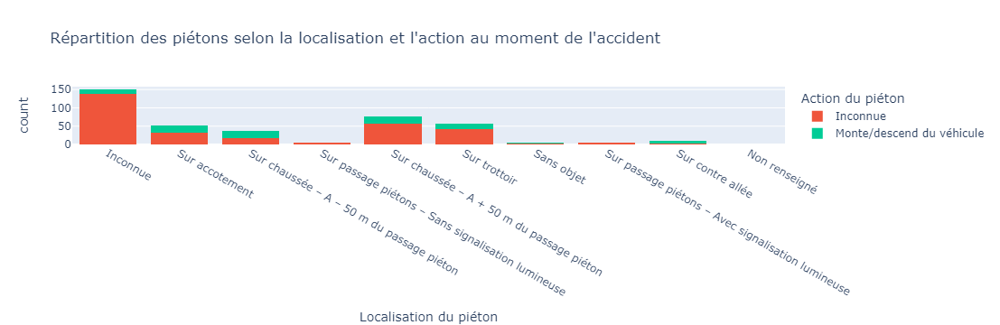

In [122]:
localisation_pieton = {-1:'Non renseigné',0:'Sans objet',
                       1:'Sur chaussée – A + 50 m du passage piéton',2:'Sur chaussée – A – 50 m du passage piéton',
                       3:'Sur passage piétons – Sans signalisation lumineuse',4:'Sur passage piétons – Avec signalisation lumineuse',
                       5:'Sur trottoir',6:'Sur accotement',7:'Sur refuge ou BAU',8:'Sur contre allée',9:'Inconnue'}
action_pieton = {-1:'Non renseigné',0:'Non renseigné ou sans objet',1:'Sens véhicule heurtant',2:'Sens inverse du véhicule',
                 3:'Traversant',4:'Masqué',5:'Jouant – courant',6:'Avec animal',9:'Autre','A':'Monte/descend du véhicule','B':'Inconnue'}
usagers['localisation_pieton'] = usagers['locp'].map(localisation_pieton)
usagers['action_pieton'] = usagers['actp'].map(action_pieton)
px.histogram(usagers, x='localisation_pieton', color='action_pieton',
                   labels={'localisation_pieton': 'Localisation du piéton', 'action_pieton': 'Action du piéton'},
                   title='Répartition des piétons selon la localisation et l\'action au moment de l\'accident',
                   barmode='stack')

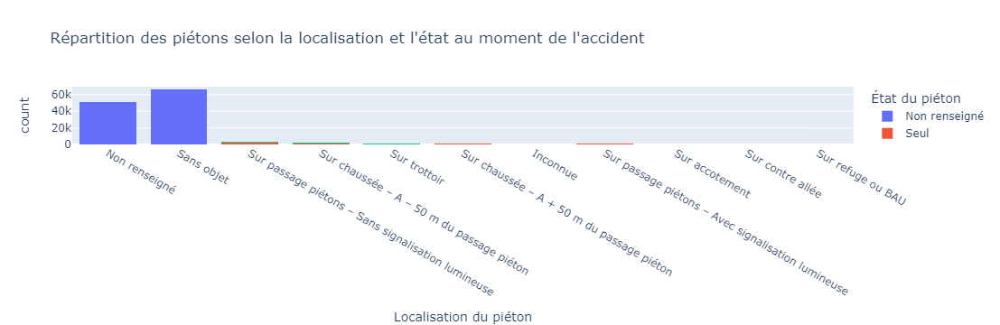

In [125]:
localisation_pieton = {-1: 'Non renseigné', 0: 'Sans objet', 1: 'Sur chaussée – A + 50 m du passage piéton',
                       2: 'Sur chaussée – A – 50 m du passage piéton',
                       3: 'Sur passage piétons – Sans signalisation lumineuse',
                       4: 'Sur passage piétons – Avec signalisation lumineuse',
                       5: 'Sur trottoir', 6: 'Sur accotement', 7: 'Sur refuge ou BAU',
                       8: 'Sur contre allée', 9: 'Inconnue'}
usagers['localisation_pieton'] = usagers['locp'].map(localisation_pieton)

etat_pieton = {-1: 'Non renseigné', 1: 'Seul', 2: 'Accompagné', 3: 'En groupe'}
usagers['état_pieton'] = usagers['etatp'].map(etat_pieton)

gravité = {1: 'Indemne', 2: 'Tué', 3: 'Blessé hospitalisé', 4: 'Blessé léger'}
usagers['gravité'] = usagers['grav'].map(gravité)

px.histogram(usagers, x='localisation_pieton', color='état_pieton',
                labels={'localisation_pieton': 'Localisation du piéton', 'état_pieton': 'État du piéton'},
                title='Répartition des piétons selon la localisation et l\'état au moment de l\'accident',
                barmode='stack')



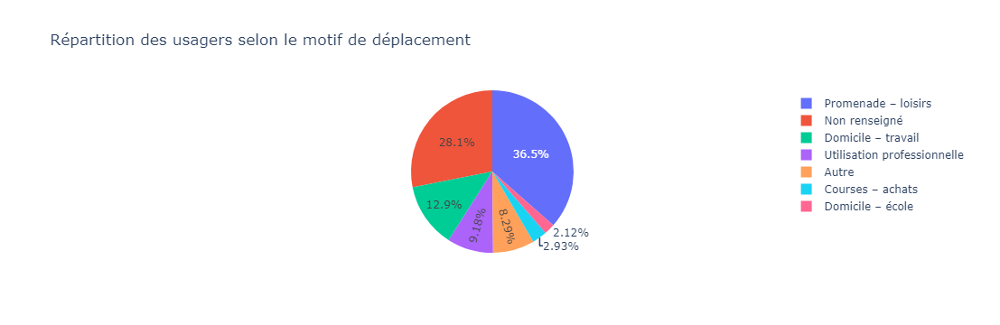

In [126]:
motif_deplacement = {-1: 'Non renseigné', 0: 'Non renseigné', 1: 'Domicile – travail', 2: 'Domicile – école',
                     3: 'Courses – achats', 4: 'Utilisation professionnelle', 5: 'Promenade – loisirs', 9: 'Autre'}
usagers['motif_déplacement'] = usagers['trajet'].map(motif_deplacement)

# Création du graphique en diagramme circulaire avec Plotly
fig = px.pie(usagers, names='motif_déplacement', title='Répartition des usagers selon le motif de déplacement')

fig.show()

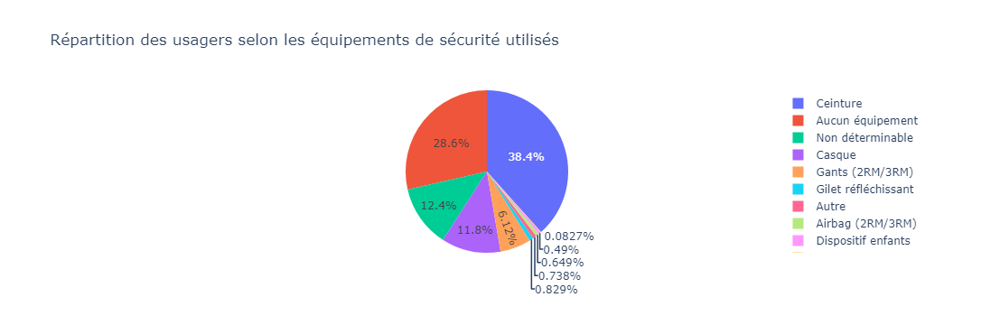

In [129]:
equipements = pd.melt(usagers, value_vars=['secu1', 'secu2', 'secu3'], var_name='equipement', value_name='code')

securite = {-1: 'Non renseigné', 0: 'Aucun équipement', 1: 'Ceinture', 2: 'Casque', 3: 'Dispositif enfants',
            4: 'Gilet réfléchissant', 5: 'Airbag (2RM/3RM)', 6: 'Gants (2RM/3RM)', 7: 'Gants + Airbag (2RM/3RM)',
            8: 'Non déterminable', 9: 'Autre'}
equipements['équipements_sécurité'] = equipements['code'].map(securite)

equipements = equipements[equipements['équipements_sécurité'] != 'Non renseigné']


px.pie(equipements, names='équipements_sécurité', title='Répartition des usagers selon les équipements de sécurité utilisés')

### Num_Acc
Identifiant de l’accident identique à celui du fichier "rubrique CARACTERISTIQUES" repris pour chacun des usagers décrits impliqués dans l’accident.
### id_usager
Identifiant unique de l’usager (y compris les piétons qui sont rattachés aux véhicules qui les ont heurtés) – Code numérique.
### id_vehicule
Identifiant unique du véhicule repris pour chacun des usagers occupant ce véhicule (y compris les piétons qui sont rattachés aux véhicules qui les ont heurtés) – Code numérique.
### num_Veh
Identifiant du véhicule repris pour chacun des usagers occupant ce véhicule (y compris les piétons qui sont rattachés aux véhicules qui les ont heurtés) – Code alphanumérique.
### place
Permet de situer la place occupée dans le véhicule par l'usager au moment de l'accident. Le détail est donné par l’illustration ci-dessous :
10 – Piéton (non applicable)
### catu
Catégorie d'usager :

1 – Conducteur

2 – Passager

3 – Piéton

### grav
Gravité de blessure de l'usager, les usagers accidentés sont classés en trois catégories de victimes plus les indemnes :

1 – Indemne

2 – Tué

3 – Blessé hospitalisé

4 – Blessé léger

### sexe
Sexe de l'usager :

1 – Masculin

2 – Féminin

### An_nais
Année de naissance de l'usager.
### trajet
Motif du déplacement au moment de l’accident :

-1 – Non renseigné

0 – Non renseigné

1 – Domicile – travail

2 – Domicile – école

3 – Courses – achats

4 – Utilisation professionnelle

5 – Promenade – loisirs

9 – Autre

Les équipements de sécurité jusqu’en 2018 étaient en 2 variables : existence et utilisation.
A partir de 2019, il s’agit de l’utilisation avec jusqu’à 3 équipements possibles pour un même usager (notamment pour les motocyclistes dont le port du casque et des gants est obligatoire).
### secu1
Le renseignement du caractère indique la présence et l’utilisation de l’équipement de sécurité :

-1 – Non renseigné

0 – Aucun équipement

1 – Ceinture

2 – Casque

3 – Dispositif enfants

4 – Gilet réfléchissant

5 – Airbag (2RM/3RM)

6 – Gants (2RM/3RM)

7 – Gants + Airbag (2RM/3RM)

8 – Non déterminable

9 – Autre

### secu2
Le renseignement du caractère indique la présence et l’utilisation de l’équipement de sécurité :

-1 – Non renseigné

0 – Aucun équipement

1 – Ceinture

2 – Casque

3 – Dispositif enfants

4 – Gilet réfléchissant

5 – Airbag (2RM/3RM)

6 – Gants (2RM/3RM)

7 – Gants + Airbag (2RM/3RM)

8 – Non déterminable

9 – Autre

### secu3
Le renseignement du caractère indique la présence et l’utilisation de l’équipement de sécurité :

-1 – Non renseigné

0 – Aucun équipement

1 – Ceinture

2 – Casque

3 – Dispositif enfants

4 – Gilet réfléchissant

5 – Airbag (2RM/3RM)

6 – Gants (2RM/3RM)

7 – Gants + Airbag (2RM/3RM)

8 – Non déterminable

9 – Autre

### locp
Localisation du piéton :

-1 – Non renseigné

0 – Sans objet

### Sur chaussée :
1 – A + 50 m du passage piéton

2 – A – 50 m du passage piéton
### Sur passage piéton :
3 – Sans signalisation lumineuse

4 – Avec signalisation lumineuse
### Divers :
5 – Sur trottoir

6 – Sur accotement

7 – Sur refuge ou BAU

8 – Sur contre allée

9 – Inconnue

### actp
Action du piéton :

-1 – Non renseigné

Se déplaçant

0 – Non renseigné ou sans objet

1 – Sens véhicule heurtant

2 – Sens inverse du véhicule

Divers

3 – Traversant

4 – Masqué

5 – Jouant – courant

6 – Avec animal

9 – Autre

A – Monte/descend du véhicule

B – Inconnue

### etatp
Cette variable permet de préciser si le piéton accidenté était seul ou non :

-1 – Non renseigné

1 – Seul

2 – Accompagné

3 – En groupe


In [183]:
vehicules = pd.read_csv("vehicules-2022.csv", sep=';')
vehicules.head()

,Num_Acc,id_vehicule,num_veh,senc,catv,obs,obsm,choc,manv,motor,occutc
0,202200000001,813 952,A01,1,2,0,2,1,9,1,NaN
1,202200000001,813 953,B01,1,7,0,2,2,1,1,NaN
2,202200000002,813 950,B01,2,7,0,2,8,15,1,NaN
3,202200000002,813 951,A01,2,10,0,2,1,1,1,NaN
4,202200000003,813 948,A01,2,7,0,2,1,2,1,NaN


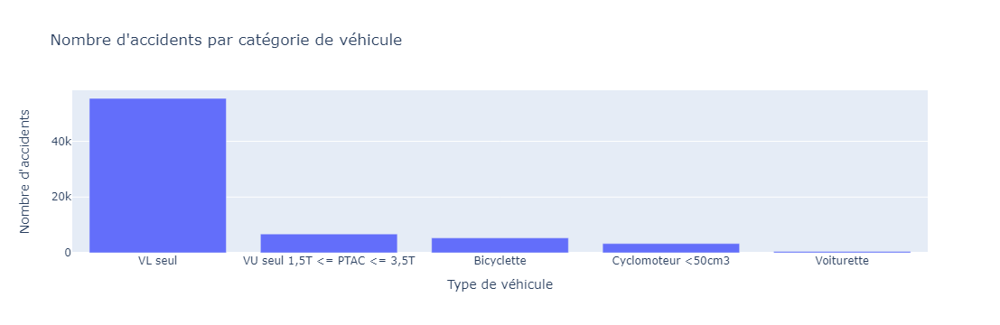

In [193]:
categories_vehicules = {
    1: 'Bicyclette',
    2: 'Cyclomoteur <50cm3',
    3: 'Voiturette',
    4: 'Scooter immatriculé',
    5: 'Motocyclette',
    6: 'Side-car',
    7: 'VL seul',
    8: 'VL + caravane',
    9: 'VL + remorque',
    10: 'VU seul 1,5T <= PTAC <= 3,5T',
}


vehicules['categorie_vehicule'] = vehicules['catv'].map(categories_vehicules)

accident_par_type_vehicule = vehicules.groupby('categorie_vehicule')['id_vehicule'].count().sort_values(ascending=False)

data = pd.DataFrame({'Type de véhicule': accident_par_type_vehicule.index, 
                     "Nombre d'accidents": accident_par_type_vehicule.values})

px.bar(data, x='Type de véhicule', y="Nombre d'accidents", 
             title="Nombre d'accidents par catégorie de véhicule",
             labels={'Type de véhicule':'Type de véhicule',"Nombre d'accidents":'Nombre d\'accidents'})

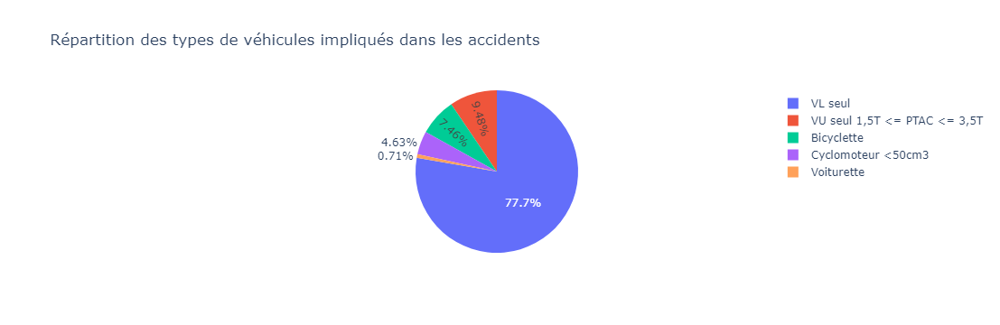

In [194]:
accidents_par_type_vehicule = vehicules['categorie_vehicule'].value_counts()

px.pie(names=accidents_par_type_vehicule.index, values=accidents_par_type_vehicule.values, 
             title="Répartition des types de véhicules impliqués dans les accidents")


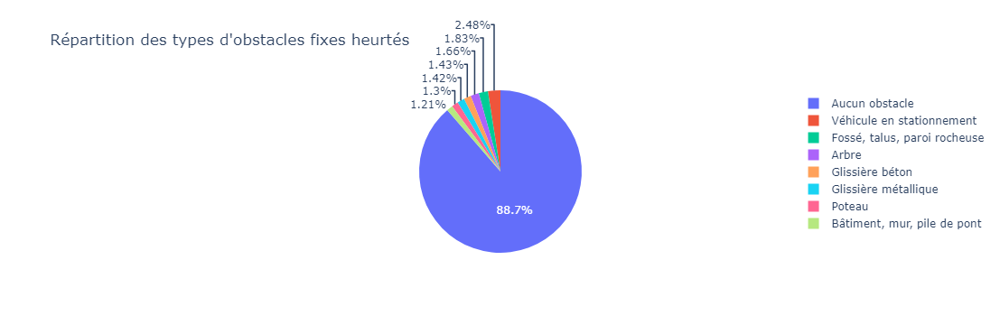

In [186]:
accidents_par_obstacle_fixe = vehicules.groupby('obs').size().reset_index(name='count')

types_obstacles_fixes = {
    0:'Aucun obstacle',
    1:'Véhicule en stationnement',
    2:'Arbre',
    3:'Glissière métallique',
    4:'Glissière béton',
    5:'Autre glissière',
    6:'Bâtiment, mur, pile de pont',
    7:'Support de signalisation verticale ou poste d’appel d’urgence',
    8:'Poteau',
    9:'Mobilier urbain',
    10:'Parapet',
    11:'Ilot, refuge, borne haute',
    12:'Bordure de trottoir',
    13:'Fossé, talus, paroi rocheuse',
    14:'Autre obstacle fixe sur chaussée',
    15:'Autre obstacle fixe sur trottoir ou accotement',
    16:'Sortie de chaussée sans obstacle',
    17:'Buse – tête d’aqueduc'
    }

accidents_par_obstacle_fixe['type_obstacle_fixe'] = accidents_par_obstacle_fixe['obs'].map(types_obstacles_fixes)

px.pie(accidents_par_obstacle_fixe[accidents_par_obstacle_fixe['count'] > 1000], 
       values='count', 
       names='type_obstacle_fixe',
       title='Répartition des types d\'obstacles fixes heurtés')

In [191]:
vehicules.head()

,Num_Acc,id_vehicule,num_veh,senc,catv,obs,obsm,choc,manv,motor,occutc
0,202200000001,813 952,A01,1,2,0,2,1,9,1,NaN
1,202200000001,813 953,B01,1,7,0,2,2,1,1,NaN
2,202200000002,813 950,B01,2,7,0,2,8,15,1,NaN
3,202200000002,813 951,A01,2,10,0,2,1,1,1,NaN
4,202200000003,813 948,A01,2,7,0,2,1,2,1,NaN


In [213]:
choc_libelle = {-1:'Non renseigné',0:'Aucun',1:'Avant',2:'Avant droit',3:'Avant gauche',4:'Arrière',5:'Arrière droit',
                6:'Arrière gauche',7:'Côté droit',8:'Côté gauche',9:'Chocs multiples (tonneaux)'}
vehicules['choc_libelle']=vehicules['choc'].map(choc_libelle)
points = pd.DataFrame(vehicules.groupby(['choc_libelle', "categorie_vehicule"])['id_vehicule'].count()).reset_index()
points



,choc_libelle,categorie_vehicule,id_vehicule
0,Arrière,Bicyclette,509
1,Arrière,Cyclomoteur <50cm3,156
2,Arrière,VL seul,6499
3,Arrière,"VU seul 1,5T <= PTAC <= 3,5T",840
4,Arrière,Voiturette,53
5,Arrière droit,Bicyclette,81
6,Arrière droit,Cyclomoteur <50cm3,45
7,Arrière droit,VL seul,1784
8,Arrière droit,"VU seul 1,5T <= PTAC <= 3,5T",273
9,Arrière droit,Voiturette,14


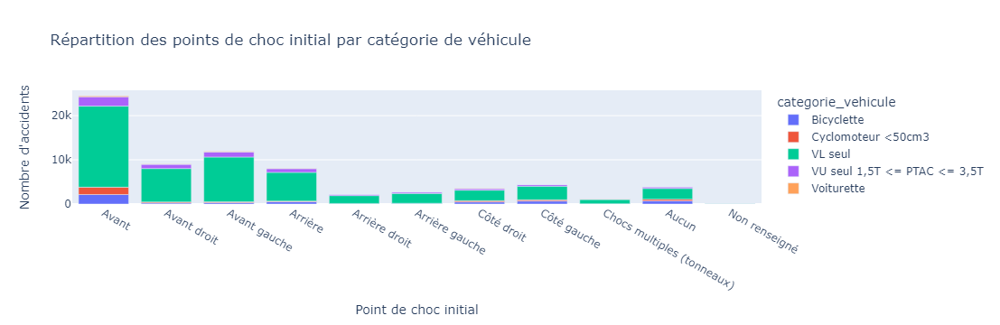

In [218]:
px.bar(points, x='choc_libelle', y='id_vehicule', color='categorie_vehicule', 
             title="Répartition des points de choc initial par catégorie de véhicule",
             labels={'choc_libelle': 'Point de choc initial', 'id_vehicule': "Nombre d'accidents"},
             category_orders={'choc_libelle': ['Avant', 'Avant droit', 'Avant gauche', 'Arrière', 
                                        'Arrière droit', 'Arrière gauche', 'Côté droit', 'Côté gauche', 
                                        'Chocs multiples (tonneaux)']})

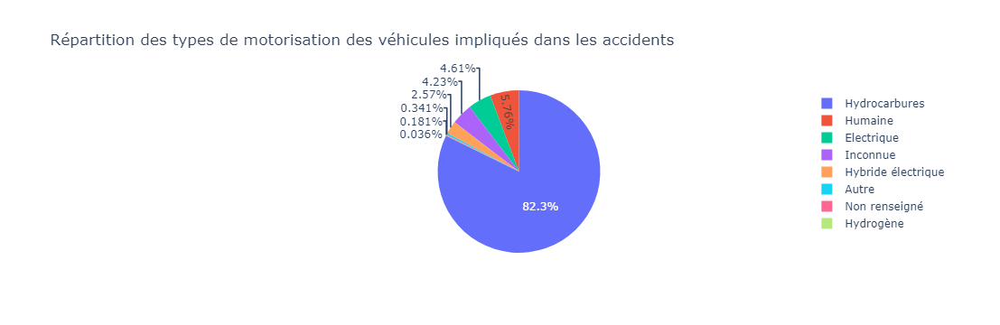

In [222]:
motorisation = {-1:'Non renseigné',0:'Inconnue',1:'Hydrocarbures',2:'Hybride électrique',3:'Electrique',4:'Hydrogène',
                5:'Humaine',6:'Autre'}
vehicules['motorisation']=vehicules['motor'].map(motorisation)

repartition_motorisation = vehicules.groupby('motorisation')['id_vehicule'].count()

px.pie(repartition_motorisation, 
            names=repartition_motorisation.index, 
            values=repartition_motorisation.values,
            title="Répartition des types de motorisation des véhicules impliqués dans les accidents")

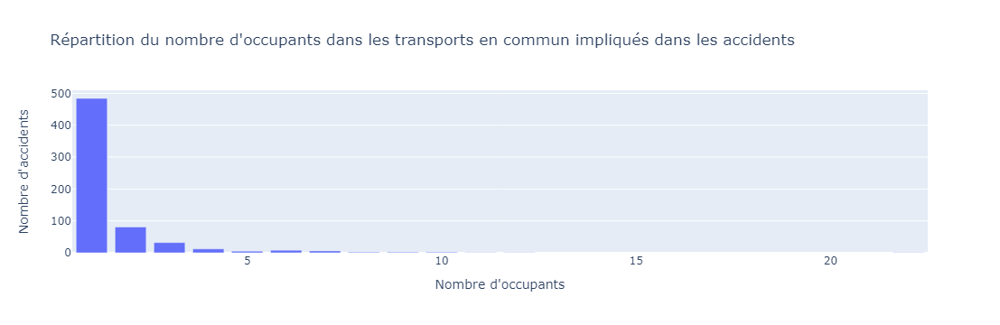

In [228]:
transports_en_commun = vehicules[vehicules['catv'] == 37]

nombre_accidents_par_occupants = transports_en_commun['occutc'].value_counts().reset_index()
nombre_accidents_par_occupants.columns = ['Nombre d\'occupants', 'Nombre d\'accidents']

px.bar(nombre_accidents_par_occupants, 
              x='Nombre d\'occupants', 
              y='Nombre d\'accidents',
              title="Répartition du nombre d'occupants dans les transports en commun impliqués dans les accidents",
              labels={'Nombre d\'occupants': "Nombre d'occupants", 'Nombre d\'accidents': "Nombre d'accidents"})

### Num_Acc
Identifiant de l’accident identique à celui du fichier "rubrique CARACTERISTIQUES" repris pour chacun des véhicules décrits impliqués dans l’accident.
### id_vehicule
Identifiant unique du véhicule repris pour chacun des usagers occupant ce véhicule (y compris les piétons qui sont rattachés aux véhicules qui les ont heurtés) – Code numérique.
### Num_Veh
Identifiant du véhicule repris pour chacun des usagers occupant ce véhicule (y compris les piétons qui sont rattachés aux véhicules qui les ont heurtés) – Code alphanumérique.
### senc
Sens de circulation :

-1 – Non renseigné

0 – Inconnu

1 – PK ou PR ou numéro d’adresse postale croissant

2 – PK ou PR ou numéro d’adresse postale décroissant

3 – Absence de repère

### catv
Catégorie du véhicule :

00 – Indéterminable

01 – Bicyclette

02 – Cyclomoteur <50cm3

03 – Voiturette (Quadricycle à moteur carrossé) (anciennement "voiturette ou tricycle à moteur")

04 – Référence inutilisée depuis 2006 (scooter immatriculé)

05 – Référence inutilisée depuis 2006 (motocyclette)
    
06 – Référence inutilisée depuis 2006 (side-car)
    
07 – VL seul
    
08 – Référence inutilisée depuis 2006 (VL + caravane)
    
09 – Référence inutilisée depuis 2006 (VL + remorque)
    
10 – VU seul 1,5T <= PTAC <= 3,5T avec ou sans remorque (anciennement VU seul 1,5T <= PTAC <= 3,5T)
    
11 – Référence inutilisée depuis 2006 (VU (10) + caravane)
    
12 – Référence inutilisée depuis 2006 (VU (10) + remorque)
    
13 – PL seul 3,5T <PTCA <= 7,5T
    
14 – PL seul > 7,5T
    
15 – PL > 3,5T + remorque
    
16 – Tracteur routier seul
    
17 – Tracteur routier + semi-remorque
    
18 – Référence inutilisée depuis 2006 (transport en commun)
    
19 – Référence inutilisée depuis 2006 (tramway)
    
20 – Engin spécial
    
21 – Tracteur agricole
    
30 – Scooter < 50 cm3
    
31 – Motocyclette > 50 cm3 et <= 125 cm3
    
32 – Scooter > 50 cm3 et <= 125 cm3
    
33 – Motocyclette > 125 cm3
    
34 – Scooter > 125 cm3
    
35 – Quad léger <= 50 cm3 (Quadricycle à moteur non carrossé)
    
36 – Quad lourd > 50 cm3 (Quadricycle à moteur non carrossé)
    
37 – Autobus
    
38 – Autocar
    
39 – Train
    
40 – Tramway
    
41 – 3RM <= 50 cm3
    
42 – 3RM > 50 cm3 <= 125 cm3
    
43 – 3RM > 125 cm3
    
50 – EDP à moteur
    
60 – EDP sans moteur
    
80 – VAE
    
99 – Autre véhicule
    
### obs
Obstacle fixe heurté :
    
-1 – Non renseigné
    
0 – Sans objet
    
1 – Véhicule en stationnement
    
2 – Arbre
    
3 – Glissière métallique
    
4 – Glissière béton
    
5 – Autre glissière
    
6 – Bâtiment, mur, pile de pont
    
7 – Support de signalisation verticale ou poste d’appel d’urgence
    
8 – Poteau
    
9 – Mobilier urbain
    
10 – Parapet
    
11 – Ilot, refuge, borne haute

12 – Bordure de trottoir

13 – Fossé, talus, paroi rocheuse

14 – Autre obstacle fixe sur chaussée

15 – Autre obstacle fixe sur trottoir ou accotement

16 – Sortie de chaussée sans obstacle

17 – Buse – tête d’aqueduc

### obsm
Obstacle mobile heurté :

-1 – Non renseigné

0 – Aucun

1 – Piéton

2 – Véhicule

4 – Véhicule sur rail

5 – Animal domestique

6 – Animal sauvage

9 – Autre

### choc
Point de choc initial :

-1 – Non renseigné

0 – Aucun

1 – Avant

2 – Avant droit

3 – Avant gauche

4 – Arrière

5 – Arrière droit

6 – Arrière gauche

7 – Côté droit

8 – Côté gauche

9 – Chocs multiples (tonneaux)

### manv
Manoeuvre principale avant l’accident :

-1 – Non renseigné

0 – Inconnue

1 – Sans changement de direction

2 – Même sens, même file

3 – Entre 2 files

4 – En marche arrière

5 – A contresens

6 – En franchissant le terre-plein central

7 – Dans le couloir bus, dans le même sens

8 – Dans le couloir bus, dans le sens inverse

9 – En s’insérant

10 – En faisant demi-tour sur la chaussée

Changeant de file

11 – A gauche

12 – A droite

Déporté

13 – A gauche

14 – A droite

Tournant

15 – A gauche

16 – A droite

Dépassant

17 – A gauche

18 – A droite

Divers

19 – Traversant la chaussée

20 – Manoeuvre de stationnement

21 – Manoeuvre d’évitement

22 – Ouverture de porte

23 – Arrêté (hors stationnement)

24 – En stationnement (avec occupants
                       
25 – Circulant sur trottoir

26 – Autres manoeuvres

### motor
Type de motorisation du véhicule :

-1 – Non renseigné

0 – Inconnue

1 – Hydrocarbures

2 – Hybride électrique

3 – Electrique

4 – Hydrogène

5 – Humaine

6 – Autre

### occutc
Nombre d’occupants dans le transport en commun.